In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import matplotlib.pyplot as plt
from dataprep.eda import create_report, plot, plot_correlation, plot_missing , plot_diff
import seaborn as sns
import numpy as np
import jinja2

In [2]:
import pandas as pd
import glob
import os

path = r'.\data\weekdays' # use your path
all_files = glob.glob(os.path.join(path , "*.csv"))

li = []

for filename in all_files:
    df = pd.read_csv(filename, index_col=None, header=0)
    li.append(df)

weekday_df = pd.concat(li, axis=0, ignore_index=True)
weekday_df.drop(['Unnamed: 0'],axis=1,inplace=True)
weekday_df['Weekday'] = 1

In [3]:
weekday_df.shape

(25500, 20)

In [4]:
import pandas as pd
import glob
import os

path = r'.\data\weekends' # use your path
all_files = glob.glob(os.path.join(path , "*.csv"))

li = []

for filename in all_files:
    df = pd.read_csv(filename, index_col=None, header=0)
    li.append(df)

weekend_df = pd.concat(li, axis=0, ignore_index=True)
weekend_df.drop(['Unnamed: 0'],axis=1,inplace=True)
weekend_df['Weekday'] = 0

In [5]:
weekend_df.shape

(26207, 20)

In [6]:
final_df = pd.concat([weekday_df,weekend_df],axis=0, ignore_index=True)
final_df.shape

(51707, 20)

In [7]:
final_df.head()

,realSum,room_type,room_shared,room_private,person_capacity,host_is_superhost,multi,biz,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,Weekday
0,194.033698,Private room,False,True,2.0,False,1,0,10.0,93.0,1,5.022964,2.539380,78.690379,4.166708,98.253896,6.846473,4.90569,52.41772,1
1,344.245776,Private room,False,True,4.0,False,0,0,8.0,85.0,1,0.488389,0.239404,631.176378,33.421209,837.280757,58.342928,4.90005,52.37432,1
2,264.101422,Private room,False,True,2.0,False,0,1,9.0,87.0,1,5.748312,3.651621,75.275877,3.985908,95.386955,6.646700,4.97512,52.36103,1
3,433.529398,Private room,False,True,4.0,False,0,1,9.0,90.0,2,0.384862,0.439876,493.272534,26.119108,875.033098,60.973565,4.89417,52.37663,1
4,485.552926,Private room,False,True,2.0,True,0,0,10.0,98.0,1,0.544738,0.318693,552.830324,29.272733,815.305740,56.811677,4.90051,52.37508,1


In [8]:
final_df.nunique()

realSum                       10497
room_type                         3
room_shared                       2
room_private                      2
person_capacity                   5
host_is_superhost                 2
multi                             2
biz                               2
cleanliness_rating                9
guest_satisfaction_overall       53
bedrooms                         10
dist                          51707
metro_dist                    51707
attr_index                    51707
attr_index_norm               51688
rest_index                    51707
rest_index_norm               51688
lng                           23600
lat                           21484
Weekday                           2
dtype: int64

In [9]:
final_df.isnull().values.any()

False

In [10]:
final_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51707 entries, 0 to 51706
Data columns (total 20 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   realSum                     51707 non-null  float64
 1   room_type                   51707 non-null  object 
 2   room_shared                 51707 non-null  bool   
 3   room_private                51707 non-null  bool   
 4   person_capacity             51707 non-null  float64
 5   host_is_superhost           51707 non-null  bool   
 6   multi                       51707 non-null  int64  
 7   biz                         51707 non-null  int64  
 8   cleanliness_rating          51707 non-null  float64
 9   guest_satisfaction_overall  51707 non-null  float64
 10  bedrooms                    51707 non-null  int64  
 11  dist                        51707 non-null  float64
 12  metro_dist                  51707 non-null  float64
 13  attr_index                  517

In [11]:
categorical = [var for var in final_df.columns if final_df[var].dtype=='O']
print('There are {} categorical variables\n'.format(len(categorical)))
if len(categorical)>=1:
    print('The categorical variables :', categorical)

There are 1 categorical variables

The categorical variables : ['room_type']


In [12]:
numerical = [var for var in final_df.columns if final_df[var].dtype!='O']
print('There are {} numerical variables\n'.format(len(numerical)))
if len(numerical)>1:
    print('The numerical variables :', numerical)

There are 19 numerical variables

The numerical variables : ['realSum', 'room_shared', 'room_private', 'person_capacity', 'host_is_superhost', 'multi', 'biz', 'cleanliness_rating', 'guest_satisfaction_overall', 'bedrooms', 'dist', 'metro_dist', 'attr_index', 'attr_index_norm', 'rest_index', 'rest_index_norm', 'lng', 'lat', 'Weekday']


  0%|          | 0/3011 [00:00<?, ?it/s]

c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\dask\core.py:119: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))



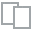
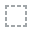
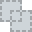
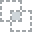
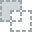
...
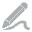
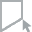
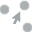
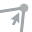
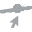

In [13]:
report = create_report(final_df)
report.show()


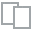
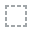
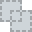
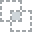
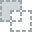
...
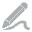
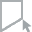
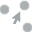
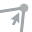
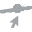

In [14]:
plot_correlation(final_df)

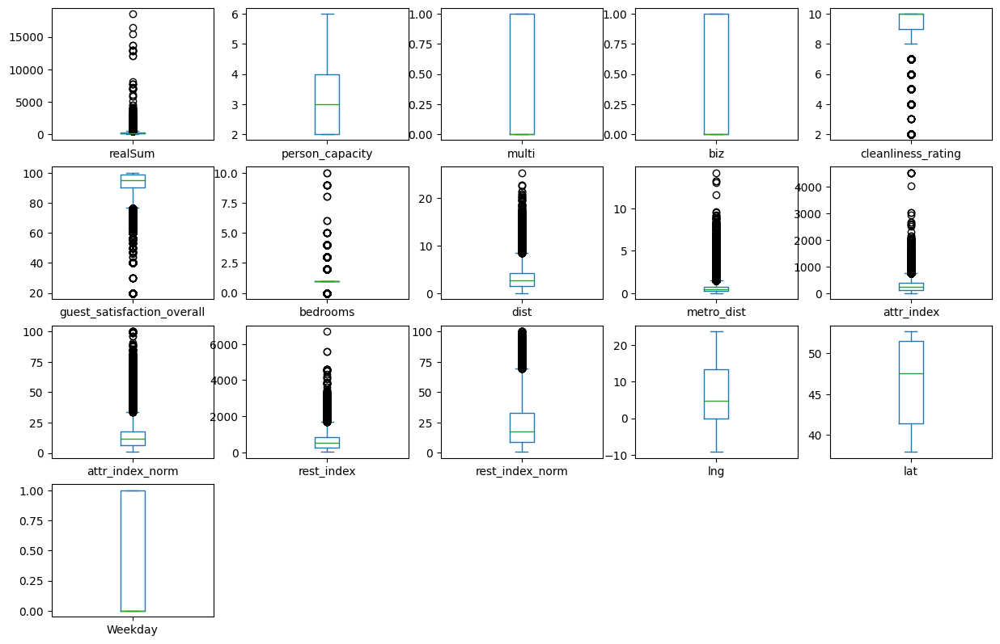

In [15]:
final_df[numerical].plot(kind = "box",subplots = True,layout = (8,5),figsize=(15,20)) #Boxplot to check the outliers
plt.show()

In [16]:
numerical

['realSum',
 'room_shared',
 'room_private',
 'person_capacity',
 'host_is_superhost',
 'multi',
 'biz',
 'cleanliness_rating',
 'guest_satisfaction_overall',
 'bedrooms',
 'dist',
 'metro_dist',
 'attr_index',
 'attr_index_norm',
 'rest_index',
 'rest_index_norm',
 'lng',
 'lat',
 'Weekday']

In [17]:
rem_list = ['realSum','dist',
 'metro_dist','attr_index',
 'attr_index_norm',
 'rest_index',
 'rest_index_norm']

In [18]:
#Using the InterQuartile Range to fill the values
def remove_outlier(i , col):
    Q1 = i[col].quantile(0.25)
    Q3 = i[col].quantile(0.75)
    IQR = Q3 - Q1
    lower_whisker = Q1-1.5*IQR
    upper_whisker = Q3+1.5*IQR
    final_df[col] = np.clip(i[col] , lower_whisker , upper_whisker)
    return i

def treat_outliers_all(df , col_list):
    for c in col_list:
        i = remove_outlier(df , c)
    return i

In [19]:
final_df.describe()

,realSum,person_capacity,multi,biz,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,Weekday
count,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.00000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000
mean,279.879591,3.161661,0.291353,0.350204,9.390624,92.628232,1.15876,3.191285,0.681540,294.204105,13.423792,626.856696,22.786177,7.426068,45.671128,0.493163
std,327.948386,1.298545,0.454390,0.477038,0.954868,8.945531,0.62741,2.393803,0.858023,224.754123,9.807985,497.920226,17.804096,9.799725,5.249263,0.499958
min,34.779339,2.000000,0.000000,0.000000,2.000000,20.000000,0.00000,0.015045,0.002301,15.152201,0.926301,19.576924,0.592757,-9.226340,37.953000,0.000000
25%,148.752174,2.000000,0.000000,0.000000,9.000000,90.000000,1.00000,1.453142,0.248480,136.797385,6.380926,250.854114,8.751480,-0.072500,41.399510,0.000000
50%,211.343089,3.000000,0.000000,0.000000,10.000000,95.000000,1.00000,2.613538,0.413269,234.331748,11.468305,522.052783,17.542238,4.873000,47.506690,0.000000
75%,319.694287,4.000000,1.000000,1.000000,10.000000,99.000000,1.00000,4.263077,0.737840,385.756381,17.415082,832.628988,32.964603,13.518825,51.471885,1.000000
max,18545.450285,6.000000,1.000000,1.000000,10.000000,100.000000,10.00000,25.284557,14.273577,4513.563486,100.000000,6696.156772,100.000000,23.786020,52.641410,1.000000


In [20]:
df2 = treat_outliers_all(final_df , rem_list)

In [21]:
df2.describe()

,realSum,person_capacity,multi,biz,cleanliness_rating,guest_satisfaction_overall,bedrooms,dist,metro_dist,attr_index,attr_index_norm,rest_index,rest_index_norm,lng,lat,Weekday
count,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.00000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000,51707.000000
mean,253.564780,3.161661,0.291353,0.350204,9.390624,92.628232,1.15876,3.107353,0.560153,284.845988,13.008448,607.869888,22.622392,7.426068,45.671128,0.493163
std,139.980925,1.298545,0.454390,0.477038,0.954868,8.945531,0.62741,2.102283,0.421947,188.071458,8.230022,436.047275,17.300573,9.799725,5.249263,0.499958
min,34.779339,2.000000,0.000000,0.000000,2.000000,20.000000,0.00000,0.015045,0.002301,15.152201,0.926301,19.576924,0.592757,-9.226340,37.953000,0.000000
25%,148.752174,2.000000,0.000000,0.000000,9.000000,90.000000,1.00000,1.453142,0.248480,136.797385,6.380926,250.854114,8.751480,-0.072500,41.399510,0.000000
50%,211.343089,3.000000,0.000000,0.000000,10.000000,95.000000,1.00000,2.613538,0.413269,234.331748,11.468305,522.052783,17.542238,4.873000,47.506690,0.000000
75%,319.694287,4.000000,1.000000,1.000000,10.000000,99.000000,1.00000,4.263077,0.737840,385.756381,17.415082,832.628988,32.964603,13.518825,51.471885,1.000000
max,576.107456,6.000000,1.000000,1.000000,10.000000,100.000000,10.00000,8.477980,1.471881,759.194875,33.966315,1705.291299,69.284287,23.786020,52.641410,1.000000


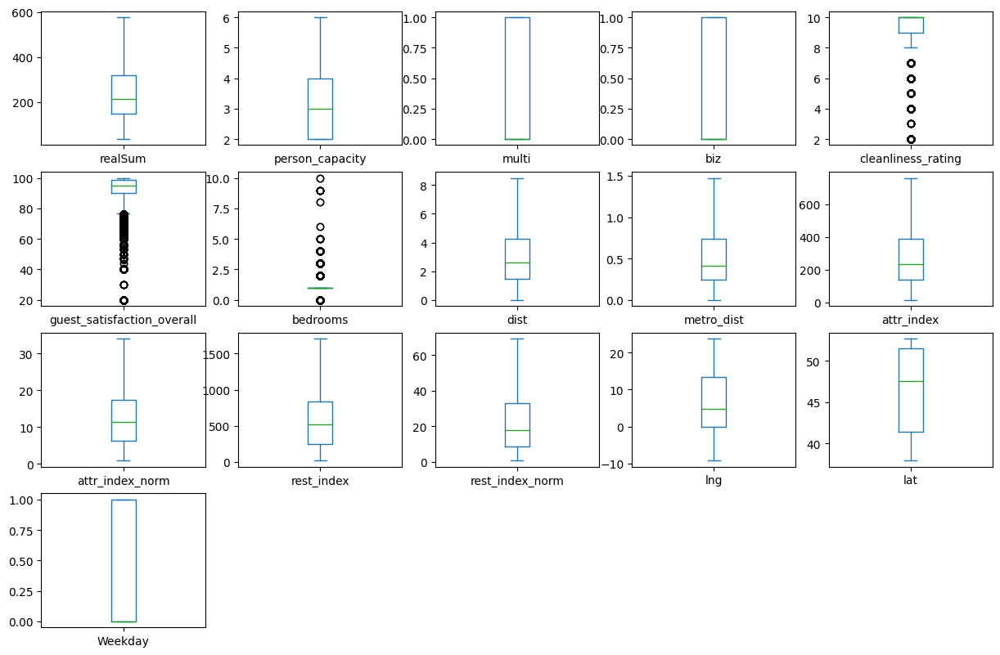

In [22]:
df2[numerical].plot(kind = "box",subplots = True,layout = (8,5),figsize=(15,20)) #Boxplot to check the outliers
plt.show()

In [23]:
df3 = pd.get_dummies(data=df2, columns=categorical,drop_first=True)
df2.shape, df3.shape

((51707, 20), (51707, 21))

Feature Engineering

In [24]:
X = df3.drop(['realSum'],axis=1)
y = df3.realSum

X.shape, y.shape

((51707, 20), (51707,))

In [25]:
# create X and Y datasets for training
from sklearn import model_selection
X_train, X_test, y_train, y_test = model_selection.train_test_split(X, y, random_state=42, test_size = 0.2)

X_train.shape, X_test.shape, y_train.shape, y_test.shape

((41365, 20), (10342, 20), (41365,), (10342,))

In [26]:
from sklearn.linear_model import LinearRegression

# initialize the linear regression model
reg = LinearRegression()

# Train the model with our training data
reg.fit(X_train, y_train)

LinearRegression()

In [27]:
y_pred_lin = reg.predict(X_test)

In [ ]:
slope = reg.coef_[0]
intercept = reg.intercept_


print(f"Slope (Coefficient): {slope}")
print(f"Intercept (Constant): {intercept}")

equation = f"y = {slope:.2f}x + {intercept:.2f}"
print(f"Equation of the line: {equation}")

In [28]:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from math import sqrt

mae_ln = mean_absolute_error(y_test,y_pred_lin)
rmse_ln = sqrt(mean_squared_error(y_test,y_pred_lin))
r_sq_ln = r2_score(y_test,y_pred_lin)

print("Mean Absolute Error: {0}\nRoot Mean Square Error: {1}\nR2 Score: {2}".format(round(mae_ln,3),round(rmse_ln,3),round(r_sq_ln,3)))

Mean Absolute Error: 71.191
Root Mean Square Error: 92.607
R2 Score: 0.564


Random Forests

In [29]:
from sklearn.preprocessing import MinMaxScaler

cols = X_train.columns
scaler = MinMaxScaler()
X_train_RF = scaler.fit_transform(X_train)
X_test_RF = scaler.transform(X_test)

X_train_RF = pd.DataFrame(X_train_RF,columns=cols)
X_test_RF = pd.DataFrame(X_test_RF,columns=cols)

In [30]:
X_train_RF.shape, X_test_RF.shape

((41365, 20), (10342, 20))

In [31]:
from sklearn.ensemble import RandomForestRegressor

rf = RandomForestRegressor(n_estimators=10)
rf.fit(X_train,y_train)

RandomForestRegressor(n_estimators=10)

In [32]:
y_pred_RF = rf.predict(X_test)

In [33]:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from math import sqrt

mae_rf = mean_absolute_error(y_test,y_pred_RF)
rmse_rf = sqrt(mean_squared_error(y_test,y_pred_RF))
r_sq_rf = r2_score(y_test,y_pred_RF)

print("Mean Absolute Error: {0}\nRoot Mean Square Error: {1}\nR2 Score: {2}".format(round(mae_rf,3),round(rmse_rf,3),round(r_sq_rf,3)))

Mean Absolute Error: 37.6
Root Mean Square Error: 56.818
R2 Score: 0.836


With 100 trees

In [34]:
from sklearn.ensemble import RandomForestRegressor

rf = RandomForestRegressor(n_estimators=100)
rf.fit(X_train,y_train)

RandomForestRegressor()

In [35]:
y_pred_RF_100 = rf.predict(X_test)
# print(y_pred_RF_100)

In [36]:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from math import sqrt

mae_rf100 = mean_absolute_error(y_test,y_pred_RF_100)
rmse_rf100 = sqrt(mean_squared_error(y_test,y_pred_RF_100))
r_sq_rf100 = r2_score(y_test,y_pred_RF_100)

print("Mean Absolute Error: {0}\nRoot Mean Square Error: {1}\nR2 Score: {2}".format(round(mae_rf100,3),round(rmse_rf100,3),round(r_sq_rf100,3)))

Mean Absolute Error: 35.658
Root Mean Square Error: 53.674
R2 Score: 0.853


In [37]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV
import numpy as np
parameters = {
    'n_estimators': [100, 150, 200, 250, 300,500,1000],
    'max_depth': [10, 20, None],
    'bootstrap':[True]
}
regr = RandomForestRegressor(random_state=12)

clf = GridSearchCV(regr, parameters,verbose=10,n_jobs=6,cv=3)
clf.fit(X_train, y_train)
print("Best params: ", clf.best_params_)

Fitting 3 folds for each of 21 candidates, totalling 63 fits
Best params:  {'bootstrap': True, 'max_depth': None, 'n_estimators': 1000}


In [38]:
y_pred_RF_cv = clf.predict(X_test)
# print(y_pred_RF_100)

In [39]:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from math import sqrt

mae_rfcv = mean_absolute_error(y_test,y_pred_RF_cv)
rmse_rfcv = sqrt(mean_squared_error(y_test,y_pred_RF_cv))
r_sq_rfcv = r2_score(y_test,y_pred_RF_cv)

print("Mean Absolute Error: {0}\nRoot Mean Square Error: {1}\nR2 Score: {2}".format(round(mae_rfcv,3),round(rmse_rfcv,3),round(r_sq_rfcv,3)))

Mean Absolute Error: 35.531
Root Mean Square Error: 53.289
R2 Score: 0.855


ANN

In [40]:
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
from sklearn.pipeline import Pipeline
# Importing libraries for building the neural network
from keras.models import Sequential
from keras.layers import Dense, Dropout, Flatten
from keras.wrappers.scikit_learn import KerasClassifier
from sklearn.model_selection import StratifiedKFold, cross_val_score, KFold, train_test_split
from keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, TensorBoard
from keras.optimizers import SGD, Adam, Adadelta, RMSprop
from keras.callbacks import EarlyStopping
from sklearn.model_selection import train_test_split
from sklearn.metrics import classification_report
import tensorflow as tf

In [41]:
airbnb_model = Sequential()
airbnb_model.add(Dense(256, input_shape = (X_train.shape[1],), activation = "relu"))
airbnb_model.add(Dense(512, activation = "relu"))
airbnb_model.add(Dense(1024, activation = "relu"))
airbnb_model.add(Dropout(0.2))
airbnb_model.add(Dense(1024, activation = "relu"))
airbnb_model.add(Dense(512, activation = "relu"))
airbnb_model.add(Dense(256, activation = "relu"))
airbnb_model.add(Flatten())
airbnb_model.add(Dense(512, activation = "relu"))
airbnb_model.add(Dropout(0.5))
airbnb_model.add(Dense(512, activation = "relu"))
airbnb_model.add(Dropout(0.5))
airbnb_model.add(Dense(1, activation = "linear",kernel_regularizer = tf.keras.regularizers.l1(l=0.001)))
airbnb_model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 256)               5376      
                                                                 
 dense_1 (Dense)             (None, 512)               131584    
                                                                 
 dense_2 (Dense)             (None, 1024)              525312    
                                                                 
 dropout (Dropout)           (None, 1024)              0         
                                                                 
 dense_3 (Dense)             (None, 1024)              1049600   
                                                                 
 dense_4 (Dense)             (None, 512)               524800    
                                                                 
 dense_5 (Dense)             (None, 256)               1

In [42]:
optimizer=Adam(learning_rate=0.001, beta_1=0.9, beta_2=0.999)

# Compile the network :
airbnb_model.compile(optimizer=optimizer, loss=tf.keras.losses.MAE, metrics=[tf.keras.metrics.MAE])

In [43]:
m_loss = EarlyStopping(
    monitor="val_loss",
    min_delta=0,
    patience=20,
    verbose=1,
    mode="auto",
    baseline=None,
    restore_best_weights=True,
)

In [44]:
save_checkpoint = tf.keras.callbacks.ModelCheckpoint(filepath='airbnb_model.h5', monitor='val_loss', save_best_only=True, verbose=1)

In [45]:
history=airbnb_model.fit(X_train_RF, y_train, epochs=100,validation_split=0.2, batch_size=128, verbose=1,callbacks=[m_loss,save_checkpoint])

Epoch 1/100


c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\keras\engine\data_adapter.py:1508: FutureWarning: The behavior of `series[i:j]` with an integer-dtype index is deprecated. In a future version, this will be treated as *label-based* indexing, consistent with e.g. `series[i]` lookups. To retain the old behavior, use `series.iloc[i:j]`. To get the future behavior, use `series.loc[i:j]`.
  return t[start:end]


244/259 [===========================>..] - ETA: 0s - loss: 77.4524 - mean_absolute_error: 77.4305
Epoch 1: val_loss improved from inf to 66.85178, saving model to airbnb_model.h5
259/259 [==============================] - 3s 4ms/step - loss: 76.7383 - mean_absolute_error: 76.7164 - val_loss: 66.8518 - val_mean_absolute_error: 66.8323
Epoch 2/100
249/259 [===========================>..] - ETA: 0s - loss: 64.4998 - mean_absolute_error: 64.4813
Epoch 2: val_loss improved from 66.85178 to 56.55752, saving model to airbnb_model.h5
259/259 [==============================] - 1s 3ms/step - loss: 64.2925 - mean_absolute_error: 64.2740 - val_loss: 56.5575 - val_mean_absolute_error: 56.5400
Epoch 3/100
243/259 [===========================>..] - ETA: 0s - loss: 61.5628 - mean_absolute_error: 61.5458
Epoch 3: val_loss did not improve from 56.55752
259/259 [==============================] - 1s 3ms/step - loss: 61.6741 - mean_absolute_error: 61.6571 - val_loss: 58.4498 - val_mean_absolute_error: 58.4

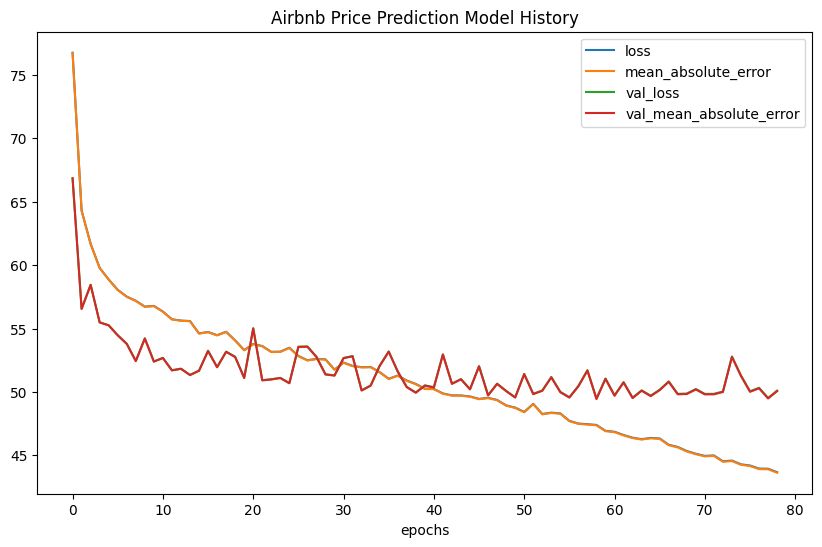

In [46]:
dfh = pd.DataFrame(history.history)
plt.figure(figsize=(10, 6))
plt.title('Airbnb Price Prediction Model History')
plt.plot(dfh)
plt.xlabel('epochs')
plt.legend(dfh.columns)
plt.show()

In [47]:
y_pred_cnn = airbnb_model.predict(X_test_RF)
# print(y_pred_cnn)

324/324 [==============================] - 0s 873us/step


In [48]:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from math import sqrt

mae_cnn = mean_absolute_error(y_test,y_pred_cnn)
rmse_cnn = sqrt(mean_squared_error(y_test,y_pred_cnn))
r_sq_cnn = r2_score(y_test,y_pred_cnn)

print("Mean Absolute Error: {0}\nRoot Mean Square Error: {1}\nR2 Score: {2}".format(round(mae_cnn,3),round(rmse_cnn,3),round(r_sq_cnn,3)))

Mean Absolute Error: 49.385
Root Mean Square Error: 73.485
R2 Score: 0.725


lgbm

In [49]:
import lightgbm as lgb
import xgboost as xgb
import optuna
import optuna.integration.lightgbm as lgbo


class config:
    OPTUNA_SWITCH = "on"
    OBJECTIVE = "regression"
    METRIC = "rmse"
    TEST_SIZE = 0.2

In [50]:
def tune_parameters_lgbm(X_train , y_train):
    opt_params = {
        "objective" : config.OBJECTIVE,
        "metric" : config.METRIC
    }

    reg_train = lgb.Dataset(
        X_train , 
        y_train
    )
    
    reg_eval = lgb.Dataset(
        X_test , 
        y_test,
        reference = reg_train
    )
    
    opt = lgbo.train(
        opt_params,
        reg_train,
        valid_sets = reg_eval ,
        verbose_eval = False,
        num_boost_round = 200,
        early_stopping_rounds = 100
    )
    
    return opt
if config.OPTUNA_SWITCH == "on":
    opt = tune_parameters_lgbm(X_train , y_train)  

[I 2023-03-06 13:48:40,121] A new study created in memory with name: no-name-82f64ae5-512f-4e89-812c-ab9b036c4fb0
feature_fraction, val_score: inf:   0%|          | 0/7 [00:00<?, ?it/s]c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\lightgbm\engine.py:181: UserWarning: 'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. Pass 'early_stopping()' callback via 'callbacks' argument instead.
  _log_warning("'early_stopping_rounds' argument is deprecated and will be removed in a future release of LightGBM. "
c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\lightgbm\engine.py:239: UserWarning: 'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. Pass 'log_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'verbose_eval' argument is deprecated and will be removed in a future release of LightGBM. "


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001376 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


feature_fraction, val_score: 67.332756:  14%|#4        | 1/7 [00:00<00:02,  2.66it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001116 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


feature_fraction, val_score: 67.196062:  29%|##8       | 2/7 [00:00<00:01,  2.72it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


feature_fraction, val_score: 67.196062:  43%|####2     | 3/7 [00:01<00:01,  2.80it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001350 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


feature_fraction, val_score: 67.080736:  57%|#####7    | 4/7 [00:01<00:01,  3.00it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001602 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


feature_fraction, val_score: 67.080736:  71%|#######1  | 5/7 [00:01<00:00,  3.01it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001682 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


feature_fraction, val_score: 67.080736:  86%|########5 | 6/7 [00:02<00:00,  2.97it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001515 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 67.080736:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001694 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 66.938017:   5%|5         | 1/20 [00:00<00:06,  2.90it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001279 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 66.938017:  10%|#         | 2/20 [00:00<00:05,  3.25it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001420 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 62.616987:  15%|#5        | 3/20 [00:01<00:07,  2.39it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001842 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 60.648619:  20%|##        | 4/20 [00:01<00:09,  1.76it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001347 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 58.395211:  25%|##5       | 5/20 [00:02<00:10,  1.40it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001101 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 58.395211:  30%|###       | 6/20 [00:03<00:10,  1.35it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001727 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 58.395211:  35%|###5      | 7/20 [00:04<00:10,  1.22it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001385 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 57.374378:  40%|####      | 8/20 [00:05<00:11,  1.06it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001505 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 57.374378:  45%|####5     | 9/20 [00:06<00:10,  1.05it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001469 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 57.374378:  50%|#####     | 10/20 [00:08<00:09,  1.00it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001410 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 57.374378:  55%|#####5    | 11/20 [00:09<00:09,  1.04s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001224 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 57.374378:  60%|######    | 12/20 [00:10<00:08,  1.11s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001421 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 57.374378:  65%|######5   | 13/20 [00:11<00:07,  1.09s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001502 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 57.225897:  70%|#######   | 14/20 [00:12<00:06,  1.13s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001306 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 57.225897:  75%|#######5  | 15/20 [00:13<00:04,  1.06it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001685 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 57.225897:  80%|########  | 16/20 [00:14<00:03,  1.06it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.014459 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 57.225897:  85%|########5 | 17/20 [00:15<00:02,  1.08it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001509 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 57.225897:  90%|######### | 18/20 [00:15<00:01,  1.18it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001213 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


num_leaves, val_score: 57.225897: 100%|##########| 20/20 [00:16<00:00,  1.18it/s]


[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001332 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


bagging, val_score: 57.225897:   0%|          | 0/10 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001359 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


bagging, val_score: 57.225897:  10%|#         | 1/10 [00:01<00:11,  1.33s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001709 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


bagging, val_score: 57.225897:  20%|##        | 2/10 [00:02<00:11,  1.43s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.005881 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


bagging, val_score: 57.225897:  30%|###       | 3/10 [00:04<00:10,  1.52s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001814 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


bagging, val_score: 57.225897:  40%|####      | 4/10 [00:05<00:09,  1.52s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001552 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


bagging, val_score: 57.225897:  50%|#####     | 5/10 [00:07<00:07,  1.46s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001784 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


bagging, val_score: 57.225897:  60%|######    | 6/10 [00:09<00:06,  1.55s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001627 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


bagging, val_score: 57.225897:  70%|#######   | 7/10 [00:10<00:04,  1.54s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002721 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


bagging, val_score: 57.225897:  80%|########  | 8/10 [00:12<00:03,  1.70s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002898 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


bagging, val_score: 57.225897:  90%|######### | 9/10 [00:14<00:01,  1.87s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001462 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


feature_fraction_stage2, val_score: 57.225897:   0%|          | 0/6 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001808 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


feature_fraction_stage2, val_score: 57.225897:  17%|#6        | 1/6 [00:01<00:08,  1.71s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001736 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


feature_fraction_stage2, val_score: 57.168619:  33%|###3      | 2/6 [00:03<00:06,  1.71s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001489 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


feature_fraction_stage2, val_score: 57.168619:  50%|#####     | 3/6 [00:05<00:05,  1.72s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001388 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


feature_fraction_stage2, val_score: 57.168619:  67%|######6   | 4/6 [00:06<00:03,  1.76s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001961 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


feature_fraction_stage2, val_score: 57.097809:  83%|########3 | 5/6 [00:08<00:01,  1.65s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002144 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:   0%|          | 0/20 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001358 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:   5%|5         | 1/20 [00:01<00:24,  1.27s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  10%|#         | 2/20 [00:02<00:26,  1.47s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001620 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  15%|#5        | 3/20 [00:04<00:25,  1.47s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001190 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  20%|##        | 4/20 [00:05<00:21,  1.37s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001402 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  25%|##5       | 5/20 [00:06<00:19,  1.32s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001426 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  30%|###       | 6/20 [00:08<00:18,  1.30s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001885 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  35%|###5      | 7/20 [00:09<00:17,  1.34s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001586 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  40%|####      | 8/20 [00:10<00:16,  1.38s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001640 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  45%|####5     | 9/20 [00:12<00:14,  1.31s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001698 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  50%|#####     | 10/20 [00:13<00:13,  1.30s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002511 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  55%|#####5    | 11/20 [00:14<00:12,  1.37s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001494 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  60%|######    | 12/20 [00:16<00:10,  1.30s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001626 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  65%|######5   | 13/20 [00:17<00:08,  1.28s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001525 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  70%|#######   | 14/20 [00:18<00:07,  1.28s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001773 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  75%|#######5  | 15/20 [00:19<00:06,  1.26s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001276 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  80%|########  | 16/20 [00:21<00:05,  1.26s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001421 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  85%|########5 | 17/20 [00:22<00:03,  1.25s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001450 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  90%|######### | 18/20 [00:23<00:02,  1.27s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001791 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


regularization_factors, val_score: 57.097809:  95%|#########5| 19/20 [00:25<00:01,  1.35s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001324 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


min_data_in_leaf, val_score: 57.097809:   0%|          | 0/5 [00:00<?, ?it/s]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001611 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


min_data_in_leaf, val_score: 55.613167:  20%|##        | 1/5 [00:01<00:04,  1.16s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001442 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


min_data_in_leaf, val_score: 55.613167:  40%|####      | 2/5 [00:02<00:03,  1.17s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001555 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


min_data_in_leaf, val_score: 55.613167:  60%|######    | 3/5 [00:03<00:02,  1.18s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001385 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


min_data_in_leaf, val_score: 55.613167:  80%|########  | 4/5 [00:04<00:01,  1.19s/it]

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001419 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2132
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.332402


min_data_in_leaf, val_score: 55.613167: 100%|##########| 5/5 [00:06<00:00,  1.21s/it]


In [51]:
print("Best Parameter For LGBM is")
print(opt.params)

Best Parameter For LGBM is
{'objective': 'regression', 'metric': 'rmse', 'feature_pre_filter': False, 'lambda_l1': 0.0, 'lambda_l2': 0.0, 'num_leaves': 252, 'feature_fraction': 0.7520000000000001, 'bagging_fraction': 1.0, 'bagging_freq': 0, 'min_child_samples': 5, 'num_iterations': 200, 'early_stopping_round': 100}


In [52]:
lgbm_params = {**opt.params}

X_train, X_test, y_train, y_test = model_selection.train_test_split(X, y, test_size=config.TEST_SIZE, random_state=0)

lgb_train = lgb.Dataset(X_train, y_train)
lgb_eval = lgb.Dataset(X_test, y_test, reference=lgb_train)
evaluation_results = {}                       
model_lgbm = lgb.train(
    lgbm_params,
    valid_names=['train', 'valid'],           
    valid_sets=[lgb_train, lgb_eval],        
    evals_result=evaluation_results,          
    train_set=lgb_train
)

[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001364 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 2131
[LightGBM] [Info] Number of data points in the train set: 41365, number of used features: 20
[LightGBM] [Warning] Found whitespace in feature_names, replace with underlines
[LightGBM] [Info] Start training from score 253.317153
[1]	train's rmse: 130.782	valid's rmse: 130.681
Training until validation scores don't improve for 100 rounds
[2]	train's rmse: 121.707	valid's rmse: 121.899
[3]	train's rmse: 113.713	valid's rmse: 114.225
[4]	train's rmse: 107.577	valid's rmse: 108.362
[5]	train's rmse: 101.983	valid's rmse: 103.064


c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\lightgbm\engine.py:177: UserWarning: Found `num_iterations` in params. Will use it instead of argument
  _log_warning(f"Found `{alias}` in params. Will use it instead of argument")
c:\Users\shara\AppData\Local\Programs\Python\Python310\lib\site-packages\lightgbm\engine.py:260: UserWarning: 'evals_result' argument is deprecated and will be removed in a future release of LightGBM. Pass 'record_evaluation()' callback via 'callbacks' argument instead.
  _log_warning("'evals_result' argument is deprecated and will be removed in a future release of LightGBM. "


[6]	train's rmse: 96.4689	valid's rmse: 97.8955
[7]	train's rmse: 91.6794	valid's rmse: 93.4093
[8]	train's rmse: 87.4572	valid's rmse: 89.494
[9]	train's rmse: 83.9243	valid's rmse: 86.2783
[10]	train's rmse: 80.7208	valid's rmse: 83.3993
[11]	train's rmse: 78.3789	valid's rmse: 81.3591
[12]	train's rmse: 75.8766	valid's rmse: 79.1542
[13]	train's rmse: 73.6632	valid's rmse: 77.2828
[14]	train's rmse: 71.7048	valid's rmse: 75.6176
[15]	train's rmse: 70.0428	valid's rmse: 74.2321
[16]	train's rmse: 68.5934	valid's rmse: 73.0407
[17]	train's rmse: 67.2645	valid's rmse: 71.933
[18]	train's rmse: 66.0868	valid's rmse: 71.0438
[19]	train's rmse: 65.056	valid's rmse: 70.3434
[20]	train's rmse: 64.1241	valid's rmse: 69.6456
[21]	train's rmse: 63.2281	valid's rmse: 68.9912
[22]	train's rmse: 62.4303	valid's rmse: 68.4335
[23]	train's rmse: 61.6771	valid's rmse: 67.8847
[24]	train's rmse: 60.9913	valid's rmse: 67.49
[25]	train's rmse: 60.3107	valid's rmse: 67.1026
[26]	train's rmse: 59.688	val

In [53]:
y_pred_lgbm = model_lgbm.predict(X_test)

In [54]:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from math import sqrt

mae_lgbm = mean_absolute_error(y_test,y_pred_lgbm)
rmse_lgbm = sqrt(mean_squared_error(y_test,y_pred_lgbm))
r_sq_lgbm = r2_score(y_test,y_pred_lgbm)

print("Mean Absolute Error: {0}\nRoot Mean Square Error: {1}\nR2 Score: {2}".format(round(mae_lgbm,3),round(rmse_lgbm,3),round(r_sq_lgbm,3)))

Mean Absolute Error: 38.416
Root Mean Square Error: 55.022
R2 Score: 0.845


XGB

In [55]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
# can change the range to get better results
def objective(trial):
    # Define the hyperparameters to optimize
    param = {
        'objective': 'reg:squarederror',
        'eval_metric': 'rmse',
        'reg_lambda': trial.suggest_float('reg_lambda', 1e-3, 1e2, log=True),
        'learning_rate': trial.suggest_float('learning_rate', 0.001, 0.3, log=True),
        'n_estimators': trial.suggest_int('n_estimators', 50, 500, step=15),
        'lambda': trial.suggest_float('lambda', 1e-8, 1.0),
        'alpha': trial.suggest_float('alpha', 1e-8, 1.0),
        'max_depth': trial.suggest_int('max_depth', 3, 12),
        'eta': trial.suggest_float('eta', 1e-8, 1.0),
        'gamma': trial.suggest_float('gamma', 1e-8, 1.0),
        'subsample': trial.suggest_float('subsample', 0.1, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.1, 1.0),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 300),
        'n_jobs': -1
    }

    # Split the data into training and testing sets
    X_train, X_test, y_train, y_test = model_selection.train_test_split(X, y, test_size=0.2, random_state=0)

    # Train the model
    model = xgb.XGBRegressor(**param)
    model.fit(X_train, y_train)

    # Evaluate the model
    y_pred = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))

    return rmse

In [56]:
# Can change the number of trials to check for better results
study = optuna.create_study(direction='minimize')
study.optimize(objective, n_trials=50)

[I 2023-03-06 13:50:00,391] A new study created in memory with name: no-name-8153e0d8-c501-4f73-b877-9af6cfbb5229
[I 2023-03-06 13:50:06,731] Trial 0 finished with value: 68.20411633423245 and parameters: {'reg_lambda': 2.686370847263647, 'learning_rate': 0.00953044341032229, 'n_estimators': 455, 'lambda': 0.5202283308657005, 'alpha': 0.28756473791683124, 'max_depth': 12, 'eta': 0.15394956983857008, 'gamma': 0.3093870982472727, 'subsample': 0.16542832354080603, 'colsample_bytree': 0.7089802820254371, 'min_child_weight': 19}. Best is trial 0 with value: 68.20411633423245.
[I 2023-03-06 13:50:16,130] Trial 1 finished with value: 78.23815015683478 and parameters: {'reg_lambda': 34.283594435313304, 'learning_rate': 0.00539233611534866, 'n_estimators': 470, 'lambda': 0.8096278134767205, 'alpha': 0.8100445258016882, 'max_depth': 12, 'eta': 0.936734583307205, 'gamma': 0.8668256543275985, 'subsample': 0.7549888743105143, 'colsample_bytree': 0.6870885184858115, 'min_child_weight': 83}. Best is 

In [57]:
print("Important parameters For XGB is")
print(optuna.importance.get_param_importances(study))

Important parameters For XGB is
OrderedDict([('learning_rate', 0.6292797123776234), ('colsample_bytree', 0.1743441664189464), ('lambda', 0.06445615595136195), ('subsample', 0.050089527200504934), ('max_depth', 0.023534944649952202), ('gamma', 0.018865447818314528), ('eta', 0.016108840757012473), ('min_child_weight', 0.014931356436698254), ('alpha', 0.005939586687123807), ('n_estimators', 0.0018631229264680393), ('reg_lambda', 0.0005871387759940967)])


In [58]:
best_params = study.best_trial.params
print("Best Parameter For XGB is")
print(best_params)

Best Parameter For XGB is
{'reg_lambda': 1.1669257327725941, 'learning_rate': 0.06107141840317828, 'n_estimators': 485, 'lambda': 0.47589401625763733, 'alpha': 0.0315667752230411, 'max_depth': 11, 'eta': 0.8396454356574741, 'gamma': 0.6073863453283637, 'subsample': 0.6293323977171865, 'colsample_bytree': 0.5358639474487961, 'min_child_weight': 15}


In [59]:
model_xgb = xgb.XGBRegressor(objective='reg:squarederror', **best_params)
model_xgb.fit(X_train,y_train)

XGBRegressor(alpha=0.0315667752230411, base_score=0.5, booster='gbtree',
             callbacks=None, colsample_bylevel=1, colsample_bynode=1,
             colsample_bytree=0.5358639474487961, early_stopping_rounds=None,
             enable_categorical=False, eta=0.8396454356574741, eval_metric=None,
             feature_types=None, gamma=0.6073863453283637, gpu_id=-1,
             grow_policy='depthwise', importance_type=None,
             interaction_constraints='', lambda=0.47589401625763733,
             learning_rate=0.06107141840317828, max_bin=256,
             max_cat_threshold=64, max_cat_to_onehot=4, max_delta_step=0,
             max_depth=11, max_leaves=0, min_child_weight=15, missing=nan,
             monotone_constraints='()', n_estimators=485, n_jobs=0, ...)

In [60]:
y_pred_xgb = model_xgb.predict(X_test)

In [61]:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from math import sqrt

mae_xgb = mean_absolute_error(y_test,y_pred_xgb)
rmse_xgb = sqrt(mean_squared_error(y_test,y_pred_xgb))
r_sq_xgb = r2_score(y_test,y_pred_xgb)

print("Mean Absolute Error: {0}\nRoot Mean Square Error: {1}\nR2 Score: {2}".format(round(mae_xgb,3),round(rmse_xgb,3),round(r_sq_xgb,3)))

Mean Absolute Error: 40.021
Root Mean Square Error: 56.897
R2 Score: 0.834


cat

In [69]:
from catboost import CatBoostRegressor

def objective(trial):
    train_x, valid_x, train_y, valid_y = model_selection.train_test_split(X,y, test_size=0.2,random_state=0)

    param = {
        "objective": trial.suggest_categorical("objective", ["RMSE","MAE"]),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.01, 0.1),
        "depth": trial.suggest_int("depth", 1, 12),
        "learning_rate": trial.suggest_float("learning_rate",0.01,0.25),
        "boosting_type": trial.suggest_categorical("boosting_type", ["Ordered", "Plain"]),
        "bootstrap_type": trial.suggest_categorical(
        "bootstrap_type", ["Bayesian", "Bernoulli", "MVS"]
        ),
        "used_ram_limit": "6gb",
    }

    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 10)
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1)

    gbm = CatBoostRegressor(**param)

    gbm.fit(train_x, train_y, eval_set=[(valid_x, valid_y)], verbose=0, early_stopping_rounds=100)

    # Evaluate the model
    y_pred = gbm.predict(valid_x)
    rmse = np.sqrt(mean_squared_error(valid_y, y_pred))
    return rmse

In [76]:
study = optuna.create_study(direction="minimize",study_name="Catboost Classifier")
study.optimize(objective, n_trials=50, timeout=600)

[I 2023-03-06 14:13:30,822] A new study created in memory with name: Catboost Classifier
[I 2023-03-06 14:13:36,036] Trial 0 finished with value: 75.63025183888924 and parameters: {'objective': 'MAE', 'colsample_bylevel': 0.040706517337839886, 'depth': 9, 'learning_rate': 0.1750633632489012, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS'}. Best is trial 0 with value: 75.63025183888924.
[I 2023-03-06 14:13:41,264] Trial 1 finished with value: 74.92104561980595 and parameters: {'objective': 'MAE', 'colsample_bylevel': 0.095005251325873, 'depth': 3, 'learning_rate': 0.12063487212716707, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'bagging_temperature': 0.01936715014683954}. Best is trial 1 with value: 74.92104561980595.
[I 2023-03-06 14:13:44,988] Trial 2 finished with value: 74.02872455865739 and parameters: {'objective': 'MAE', 'colsample_bylevel': 0.08114788609878168, 'depth': 10, 'learning_rate': 0.024161508808741294, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS

In [77]:
print("Important parameters For cat is")
print(optuna.importance.get_param_importances(study))

Important parameters For cat is
OrderedDict([('colsample_bylevel', 0.4322337749875054), ('learning_rate', 0.23714707784301634), ('depth', 0.16248887312199792), ('objective', 0.08155975310836197), ('bootstrap_type', 0.06885921230996078), ('boosting_type', 0.017711308629157686)])


In [78]:
best_params_cat = study.best_trial.params
print("Best Parameter For cat is")
print(best_params_cat)

Best Parameter For cat is
{'objective': 'RMSE', 'colsample_bylevel': 0.09418889869810763, 'depth': 11, 'learning_rate': 0.18577451118957006, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS'}


In [79]:
model_cat = CatBoostRegressor(**best_params_cat,n_estimators=10000)
model_cat.fit(X_train,y_train,eval_set=(X_test, y_test))

0:	learn: 137.6513607	test: 137.1581925	best: 137.1581925 (0)	total: 1.97ms	remaining: 19.7s
1:	learn: 125.4220634	test: 124.7616708	best: 124.7616708 (1)	total: 4.45ms	remaining: 22.2s
2:	learn: 120.6512121	test: 119.9769662	best: 119.9769662 (2)	total: 6.03ms	remaining: 20.1s
3:	learn: 120.3689133	test: 119.6652193	best: 119.6652193 (3)	total: 7.62ms	remaining: 19s
4:	learn: 112.9358989	test: 112.3279494	best: 112.3279494 (4)	total: 10.1ms	remaining: 20.2s
5:	learn: 111.7224320	test: 111.1675649	best: 111.1675649 (5)	total: 13.2ms	remaining: 22s
6:	learn: 102.8262131	test: 102.4919240	best: 102.4919240 (6)	total: 30.3ms	remaining: 43.3s
7:	learn: 101.1912015	test: 100.9646015	best: 100.9646015 (7)	total: 31.7ms	remaining: 39.6s
8:	learn: 99.1018490	test: 98.8474956	best: 98.8474956 (8)	total: 33.1ms	remaining: 36.8s
9:	learn: 95.7400392	test: 95.5414001	best: 95.5414001 (9)	total: 35ms	remaining: 35s
10:	learn: 94.8942777	test: 94.7228875	best: 94.7228875 (10)	total: 36.3ms	remaining

In [80]:
y_pred_cat = model_cat.predict(X_test)

In [81]:
from sklearn.metrics import mean_squared_error, mean_absolute_error,r2_score
from math import sqrt

mae_cat = mean_absolute_error(y_test,y_pred_cat)
rmse_cat = sqrt(mean_squared_error(y_test,y_pred_cat))
r_sq_cat = r2_score(y_test,y_pred_cat)

print("Mean Absolute Error: {0}\nRoot Mean Square Error: {1}\nR2 Score: {2}".format(round(mae_cat,3),round(rmse_cat,3),round(r_sq_cat,3)))

Mean Absolute Error: 37.174
Root Mean Square Error: 54.258
R2 Score: 0.849


In [84]:
linear_reg_results =  pd.Series({ "MAE": mae_ln, "RMSE": rmse_ln, "R-Square": r_sq_ln }, name="Linear Regression")
rf_10_results = pd.Series({ "MAE": mae_rf, "RMSE": rmse_rf, "R-Square": r_sq_rf }, name="Random Forest-10")
rf_100_results = pd.Series({ "MAE": mae_rf100, "RMSE": rmse_rf100, "R-Square": r_sq_rf100 }, name="Random Forest-100")
rf_cv_results =  pd.Series({ "MAE": mae_rfcv, "RMSE": rmse_rfcv, "R-Square": r_sq_rfcv }, name="Random Forest-CV")
cat_results =  pd.Series({ "MAE": mae_cat, "RMSE": rmse_cat, "R-Square": r_sq_cat }, name="Catboost")
lgbm_results =  pd.Series({ "MAE": mae_lgbm, "RMSE": rmse_lgbm, "R-Square": r_sq_lgbm }, name="LGBM")
xgb_results =  pd.Series({ "MAE": mae_xgb, "RMSE": rmse_xgb, "R-Square": r_sq_xgb }, name="XGB")
cnn_results = pd.Series({ "MAE": mae_cnn, "RMSE": rmse_cnn, "R-Square": r_sq_cnn }, name="CNN")


results = pd.DataFrame([linear_reg_results, rf_10_results, rf_100_results, rf_cv_results, cat_results, lgbm_results ,xgb_results, cnn_results])
results.sort_values(by=['RMSE'],ascending=True).round(3)

,MAE,RMSE,R-Square
Random Forest-CV,35.531,53.289,0.855
Random Forest-100,35.658,53.674,0.853
Catboost,37.174,54.258,0.849
LGBM,38.416,55.022,0.845
Random Forest-10,37.600,56.818,0.836
XGB,40.021,56.897,0.834
CNN,49.385,73.485,0.725
Linear Regression,71.191,92.607,0.564
